In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms, datasets

import matplotlib.pyplot as plt
import numpy as np
import imageio

為什麼要用 np.prod(img_shape)？
1.   匹配圖像維度：


*   生成器的目的是產生與真實數據（圖片）形狀相匹配的輸出。
*   例如，如果目標是生成 28x28 像素的灰階圖像，則 img_shape 可能是 (1, 28, 28)
*   因此 np.prod(img_shape) 會是 1x28x28 = 784
*   生成器的最後一個線性層需要有 784 個輸出神經元，對應於圖像的每個像素點。
2.   圖像重塑：

*   在神經網絡中，輸出通常是一維的，而生成的圖像需要是多維的（如上述的 channels, height, width）
*   使用 np.prod(img_shape) 確保了輸出層的維度正好足以在之後的操作中被重新塑形為目標圖像的維度

3.   網絡結構的一致性：

*   確保生成器的輸出層與所需的圖像維度完全一致是重要的
*   這樣可以無縫地將網絡的輸出轉換成可視化的圖像，無需進行額外的處理或轉換

4.   簡化模型設計：

*   通過使用 np.prod(img_shape) 來設定輸出層的大小，開發者可以靈活地調整目標圖像的大小或深度（例如變更顏色通道數），而不必重新計算輸出層的大小
*   使用 np.prod(img_shape) 是為了讓生成器能夠直接生成具有所需形狀的圖像資料，這是實現圖像生成任務中的一個關鍵步驟

In [2]:
# 定義生成器
class Generator(nn.Module):
  def __init__(self, latent_dim, img_shape):
    super(Generator, self).__init__()
    self.img_shape = img_shape

    self.model = nn.Sequential(
        nn.Linear(latent_dim, 128),
        nn.LeakyReLU(0.2),
        nn.Linear(128, 256),
        nn.LeakyReLU(0.2),
        nn.Linear(256, 512),
        nn.LeakyReLU(0.2),
        nn.Linear(512, int(np.prod(img_shape))),
        nn.Tanh()
    )

  def forward(self, z):
    img = self.model(z)
    img = img.view(img.size(0), *self.img_shape)
    return img

在生成對抗網絡（GAN）的生成器中，forward 方法是負責接收潛在空間的向量 z，並透過神經網絡將其轉換成最終的圖像輸出。以下是 forward 方法的詳細步驟和目的解釋：

1.   輸入潛在向量 z

*   z 是一個來自潛在空間的向量，通常是隨機生成的，其維度由 latent_dim 決定
*   這些向量是生成過程的基礎，包含足夠的隨機性來驅動生成器創造多樣化的輸出
2.   通過神經網絡模型

*   img = self.model(z)：這一行代碼將潛在向量 z 作為輸入，通過生成器中定義的一系列神經網絡層（如線性層和作用函數等）
*   這些層逐步將維度從潛在空間轉換到最終的圖像維度的平展（flattened）形態

3.   調整輸出維度以形成圖像

*   img = img.view(img.size(0), *self.img_shape)：這行代碼將前一步產生的扁平化圖像向量重新形狀（reshape）為具有指定通道數和尺寸的圖像
*   img.size(0) 表示批量大小，即一次處理多少圖像的數量，而 *self.img_shape 則是生成器設定的目標圖像形狀，如 (channels, height, width)
4.   返回最終圖像：

*   return img：這一行將調整後的圖像數據作為輸出返回
*   這些圖像已經從一維向量轉換為多維數據格式，可以直接用於視覺化或進一步的處理
##### 目的
*   生成逼真的圖像：forward 方法的核心目標是將隨機噪聲向量 z 轉換為逼真的圖像，這些圖像應該盡可能地模仿訓練數據集中的真實圖像
*   支持批量處理：通過處理整個批量的圖像，GAN 能夠更有效地學習和優化，這在實際應用中尤為重要
*   *   *   
總之，forward 方法是生成器功能的實現核心，負責將潛在空間的抽象向量轉化為具體的圖像輸出，這是實現生成器學習目標的關鍵過程。

In [3]:
# 定義判別器
class Discriminator(nn.Module):
  def __init__(self, img_shape):
    super(Discriminator, self).__init__()

    self.model = nn.Sequential(
        nn.Linear(int(np.prod(img_shape)), 512),
        nn.LeakyReLU(0.2),
        nn.Linear(512, 256),
        nn.LeakyReLU(0.2),
        nn.Linear(256, 1),
        nn.Sigmoid()
    )

  def forward(self, img):
        img_flat = img.view(img.size(0), -1)
        validity = self.model(img_flat)
        return validity

In [4]:
# 超參數設定
latent_dim = 100
img_shape = (1, 28, 28)
lr = 0.0002
batch_size = 64
epochs = 100

sample_interval = 400

transforms.Compose: https://zhuanlan.zhihu.com/p/476220305

In [5]:
# 下載MINST資料集
# 真實照片
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

train_dataset = datasets.MNIST(root='./data', train=True, transform=transform, download=True)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

In [6]:
train_dataset[55]

(tensor([[[-1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000, -1.0000,
           -1.0000, -1.0000, -1.000

In [7]:
# 創建生成器跟判別器
generator = Generator(latent_dim, img_shape)
discriminator = Discriminator(img_shape)

In [8]:
# 定義優化器
optimizer_G = optim.Adam(generator.parameters(), lr=lr)
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr)

In [9]:
# 定義loss function
criterion = nn.BCELoss()
# https://blog.csdn.net/qq_22210253/article/details/85222093

In [10]:
# 初始化保存生成圖片的list
img_list = []

# 初始化保存loss的list
g_losses = []
d_losses = []


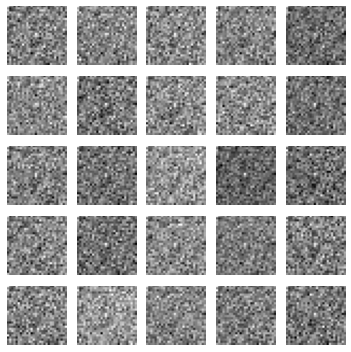

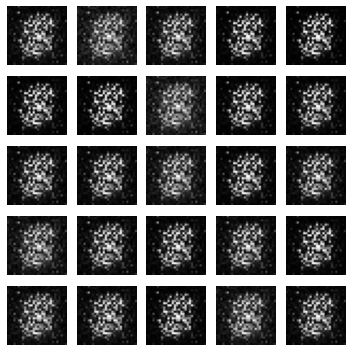

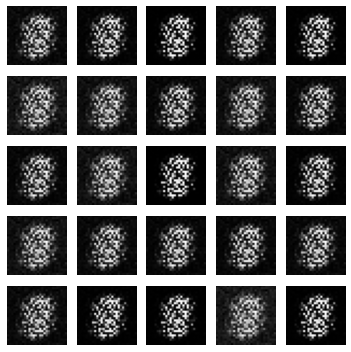

Epoch [1 / 100]  D_loss:1.5598 G_loss:0.9123 


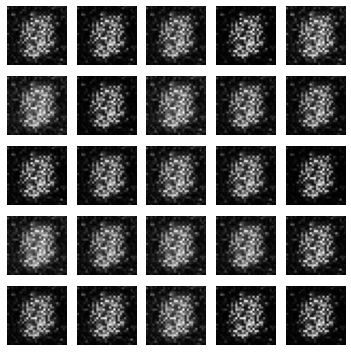

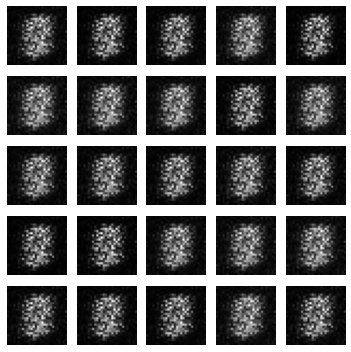

Epoch [2 / 100]  D_loss:1.1532 G_loss:0.8912 


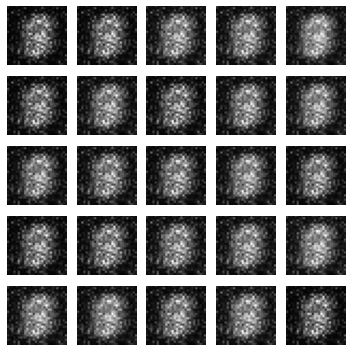

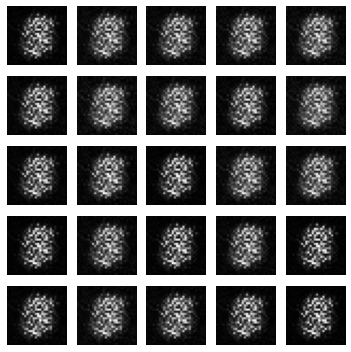

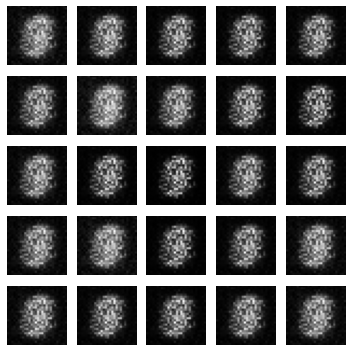

Epoch [3 / 100]  D_loss:1.9323 G_loss:0.8736 


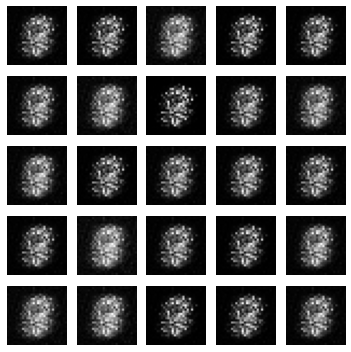

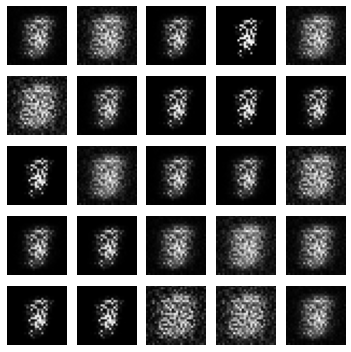

Epoch [4 / 100]  D_loss:0.5021 G_loss:2.2825 


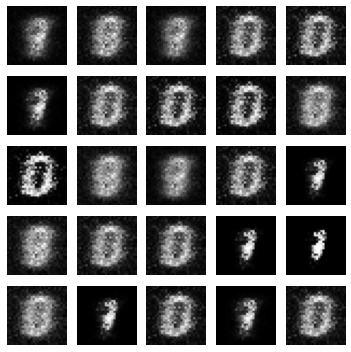

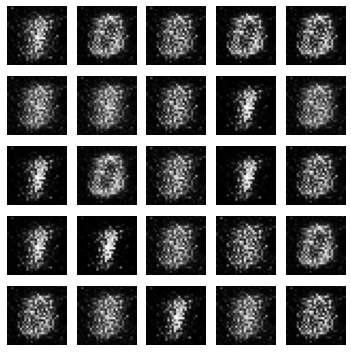

Epoch [5 / 100]  D_loss:1.2845 G_loss:3.0231 


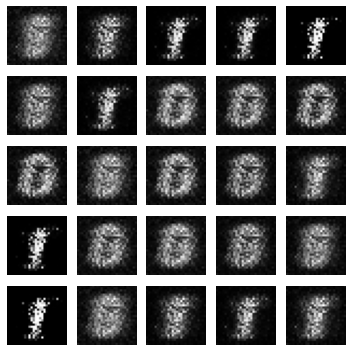

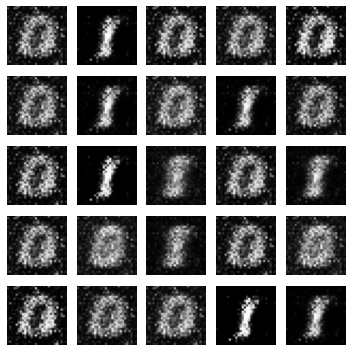

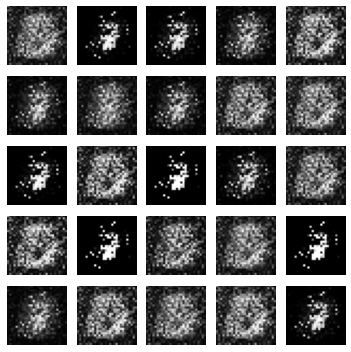

Epoch [6 / 100]  D_loss:0.8721 G_loss:3.9757 


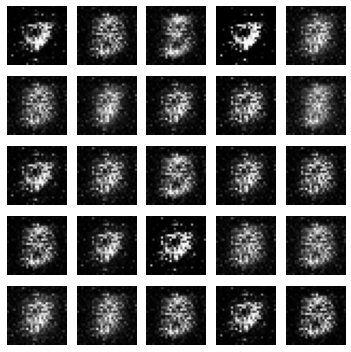

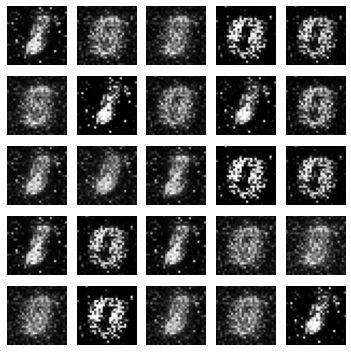

Epoch [7 / 100]  D_loss:1.3755 G_loss:2.3314 


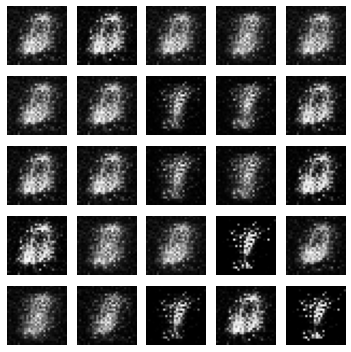

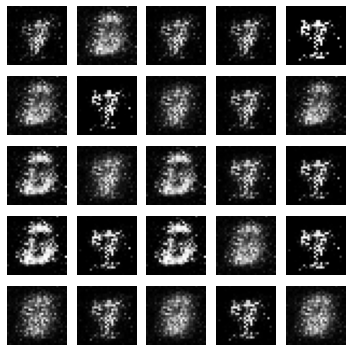

Epoch [8 / 100]  D_loss:0.7744 G_loss:3.3913 


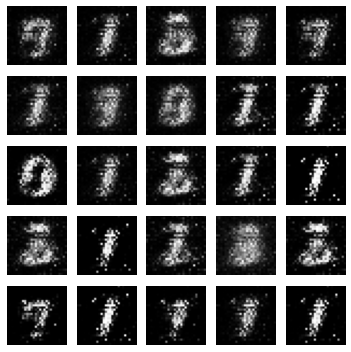

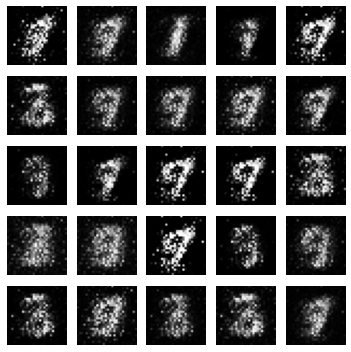

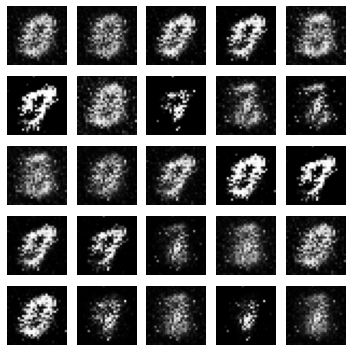

Epoch [9 / 100]  D_loss:0.5293 G_loss:2.4355 


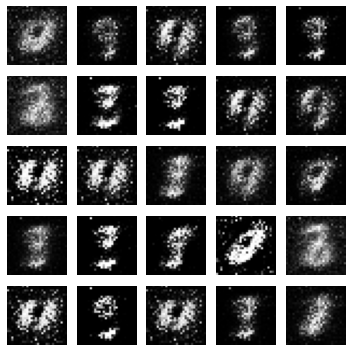

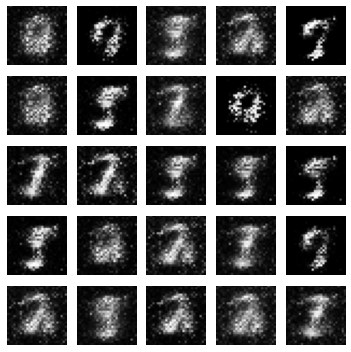

Epoch [10 / 100]  D_loss:0.2630 G_loss:3.0769 


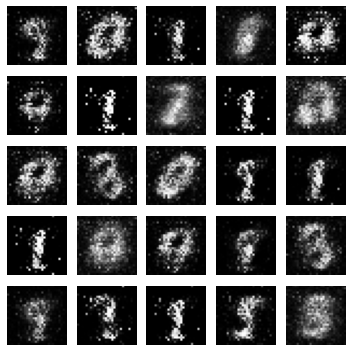

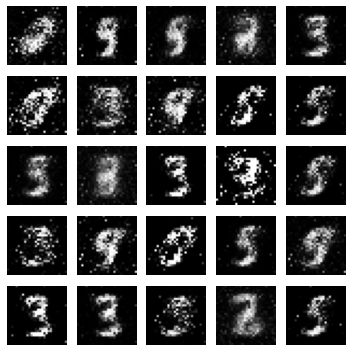

Epoch [11 / 100]  D_loss:0.4216 G_loss:2.3424 


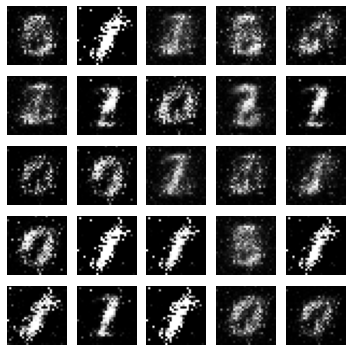

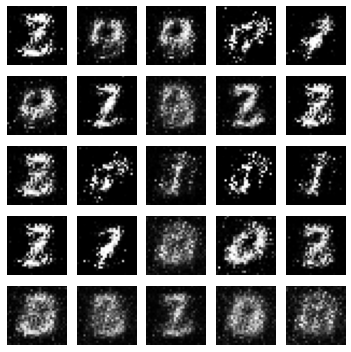

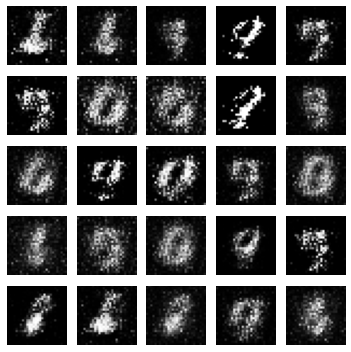

Epoch [12 / 100]  D_loss:0.5978 G_loss:1.8999 


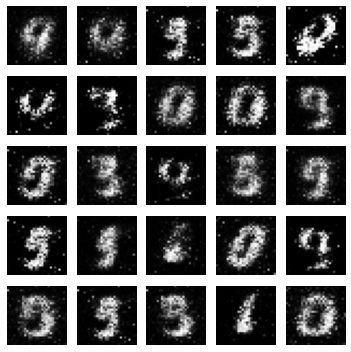

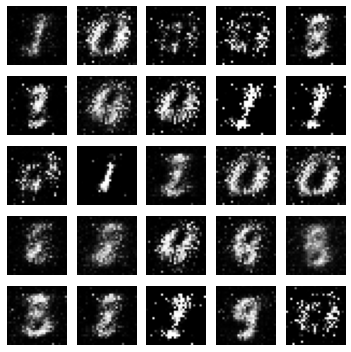

Epoch [13 / 100]  D_loss:0.5004 G_loss:4.0732 


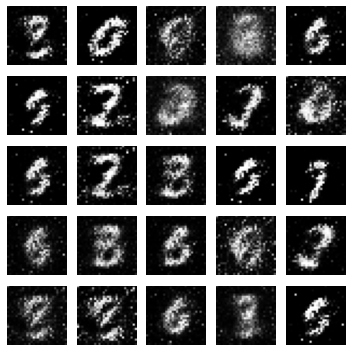

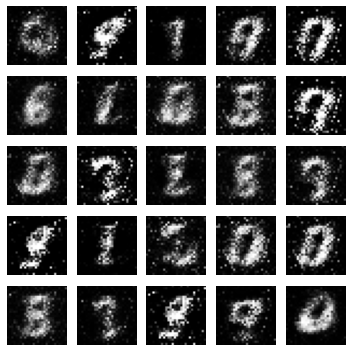

Epoch [14 / 100]  D_loss:0.8028 G_loss:2.7344 


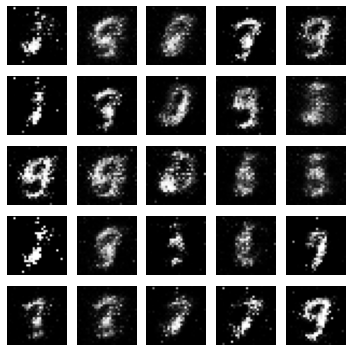

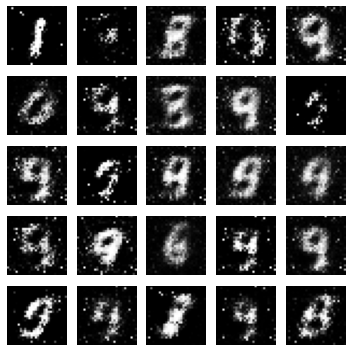

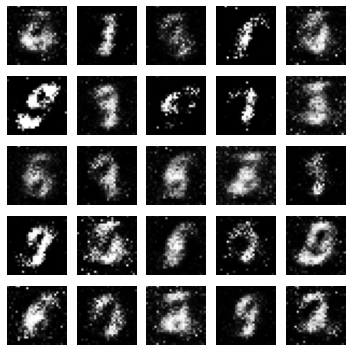

Epoch [15 / 100]  D_loss:0.4262 G_loss:3.1187 


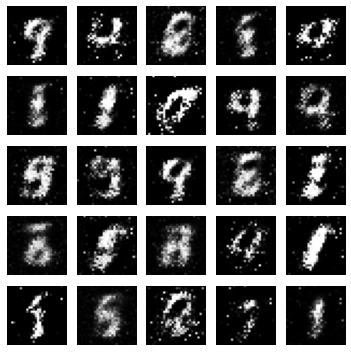

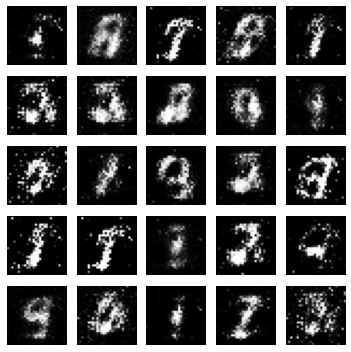

Epoch [16 / 100]  D_loss:0.8139 G_loss:2.2011 


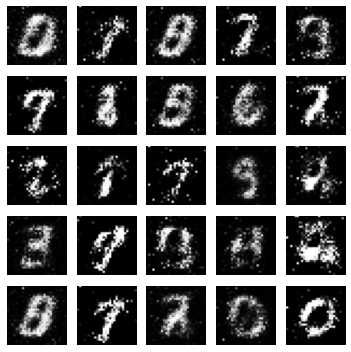

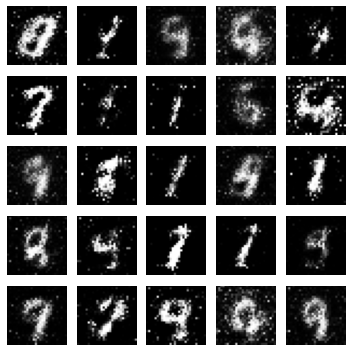

Epoch [17 / 100]  D_loss:0.4786 G_loss:3.5594 


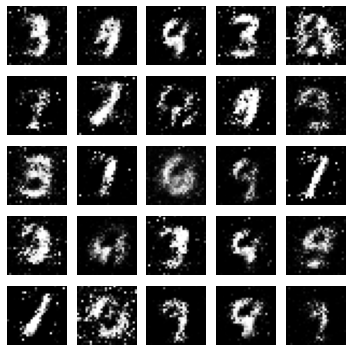

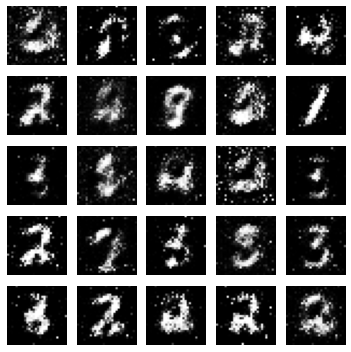

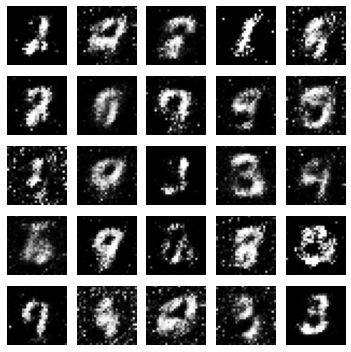

Epoch [18 / 100]  D_loss:0.7022 G_loss:1.6054 


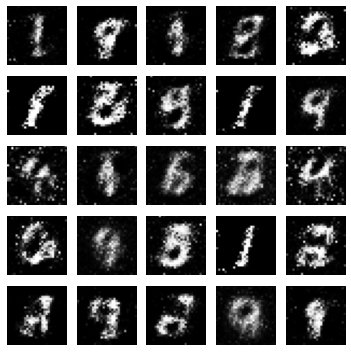

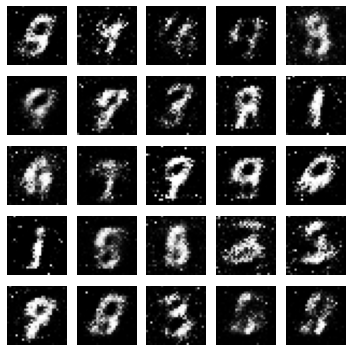

Epoch [19 / 100]  D_loss:0.5130 G_loss:2.6560 


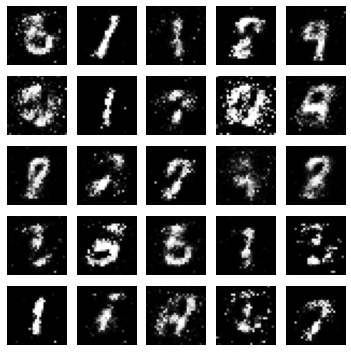

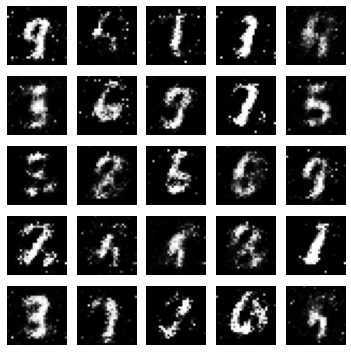

Epoch [20 / 100]  D_loss:0.9004 G_loss:3.2435 


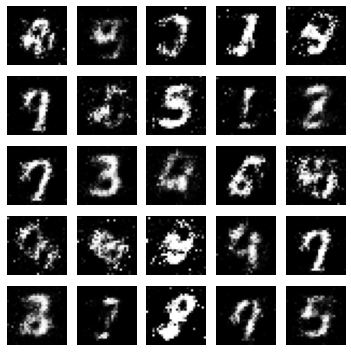

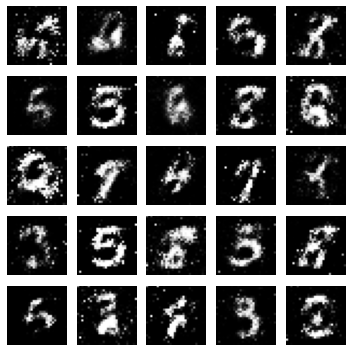

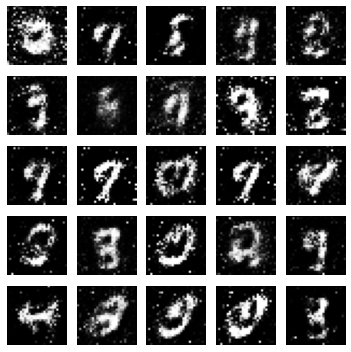

Epoch [21 / 100]  D_loss:0.7619 G_loss:2.3852 


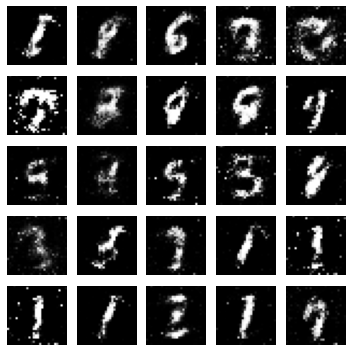

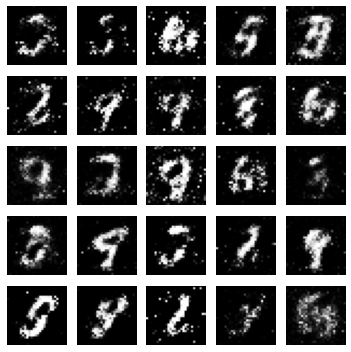

Epoch [22 / 100]  D_loss:0.5185 G_loss:3.2813 


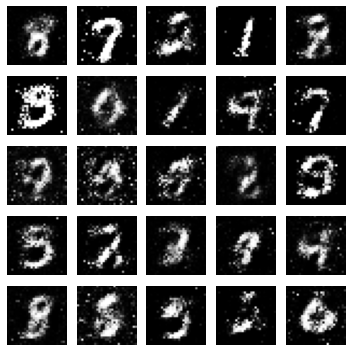

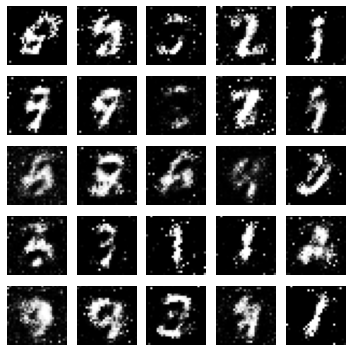

Epoch [23 / 100]  D_loss:0.6457 G_loss:1.7817 


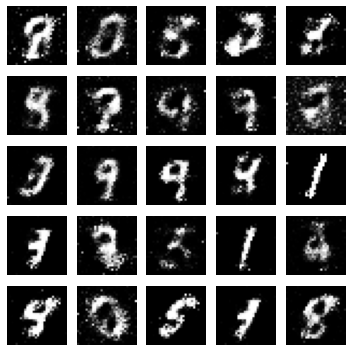

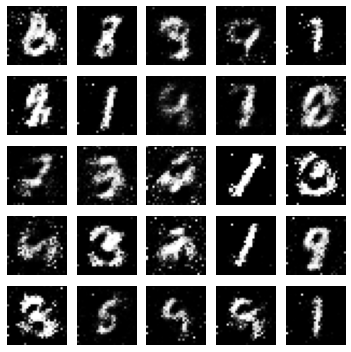

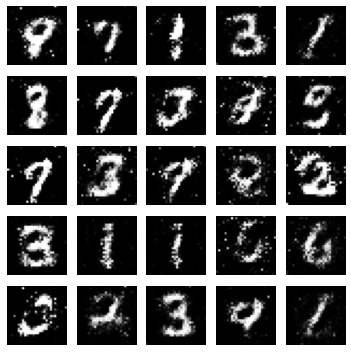

Epoch [24 / 100]  D_loss:0.9285 G_loss:2.2265 


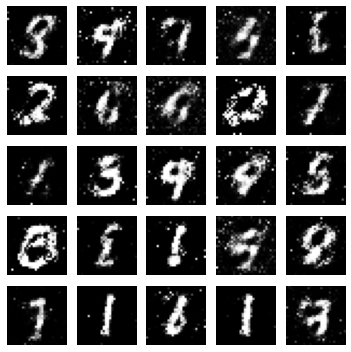

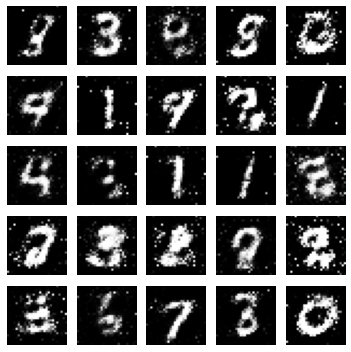

Epoch [25 / 100]  D_loss:0.7759 G_loss:1.3490 


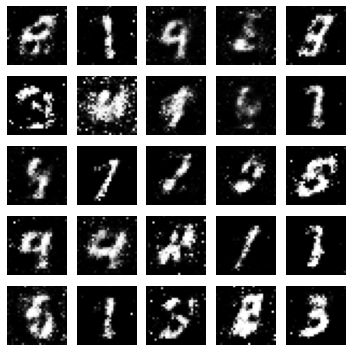

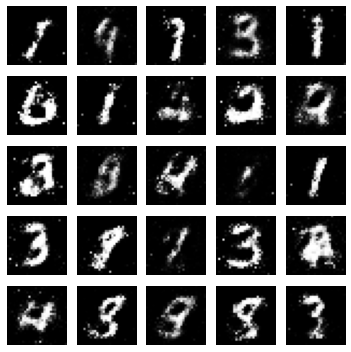

Epoch [26 / 100]  D_loss:1.1138 G_loss:2.2774 


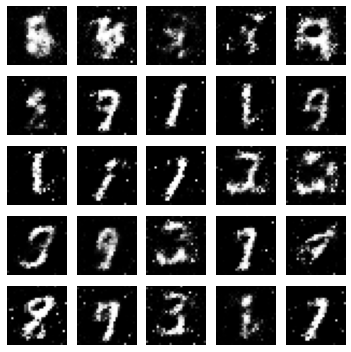

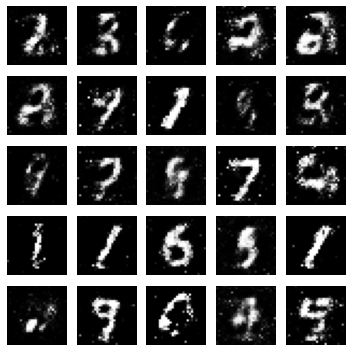

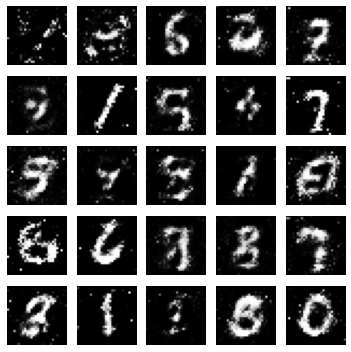

Epoch [27 / 100]  D_loss:1.0539 G_loss:1.9405 


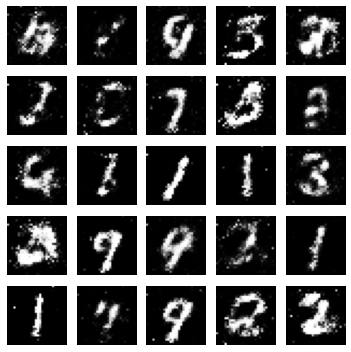

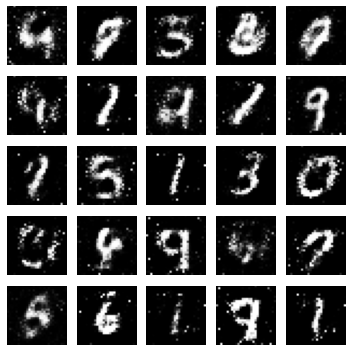

Epoch [28 / 100]  D_loss:0.6744 G_loss:2.7857 


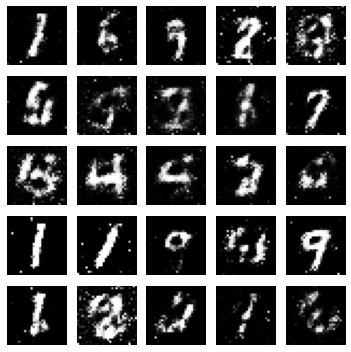

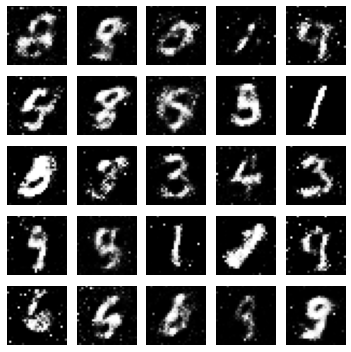

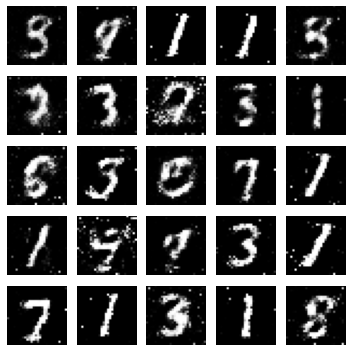

Epoch [29 / 100]  D_loss:0.8294 G_loss:1.4007 


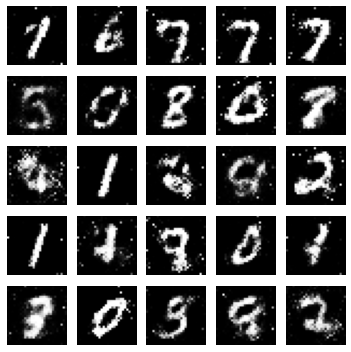

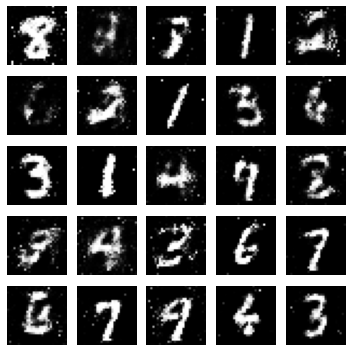

Epoch [30 / 100]  D_loss:0.8796 G_loss:2.2872 


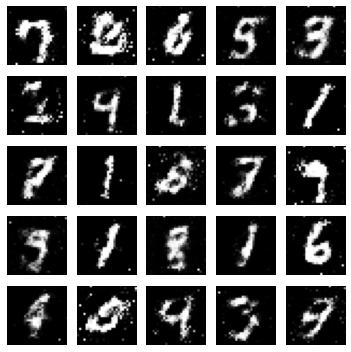

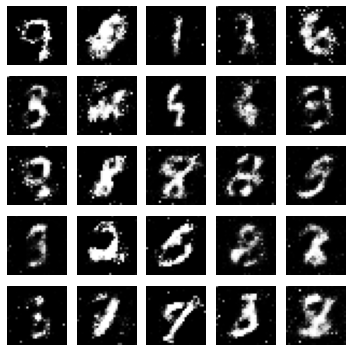

Epoch [31 / 100]  D_loss:0.6445 G_loss:1.2251 


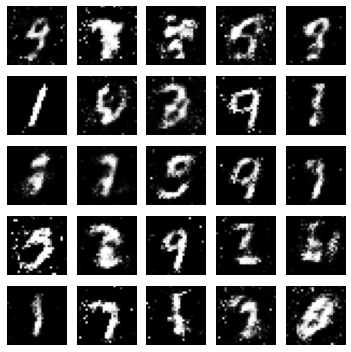

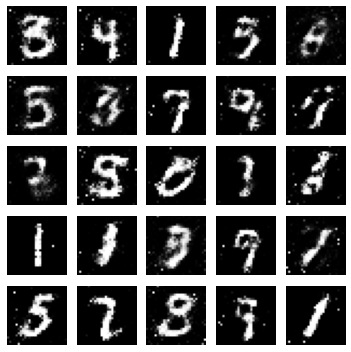

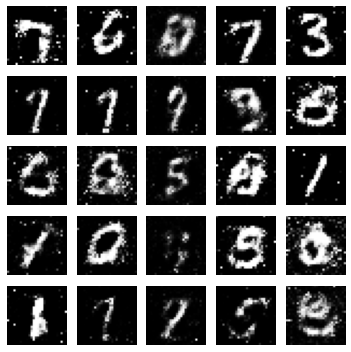

Epoch [32 / 100]  D_loss:0.7850 G_loss:1.8165 


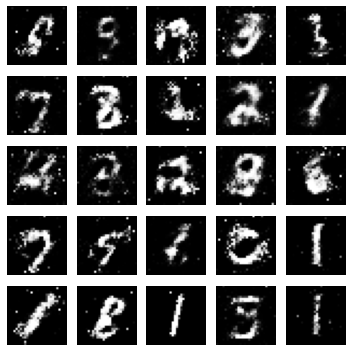

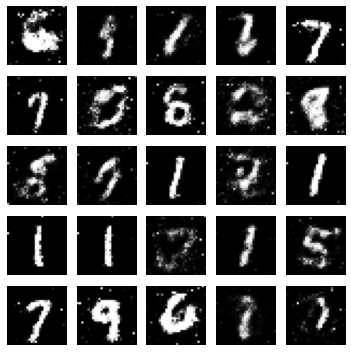

Epoch [33 / 100]  D_loss:0.8670 G_loss:1.3893 


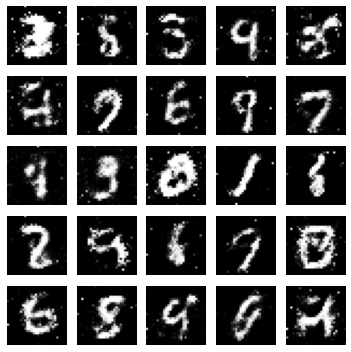

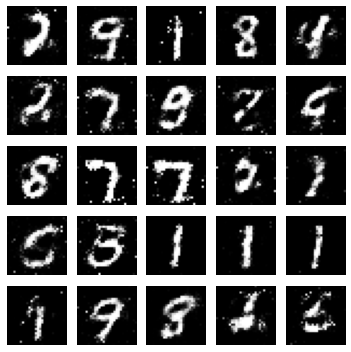

Epoch [34 / 100]  D_loss:1.1458 G_loss:1.3463 


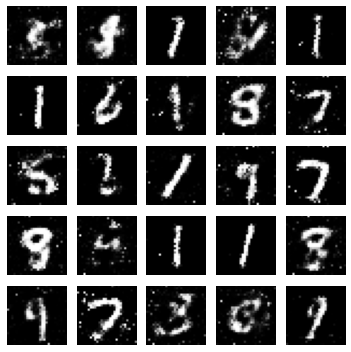

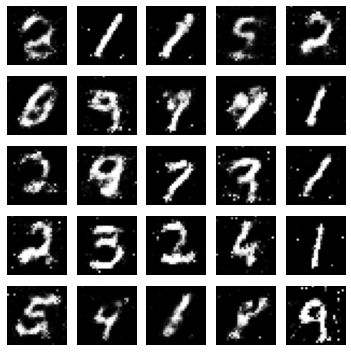

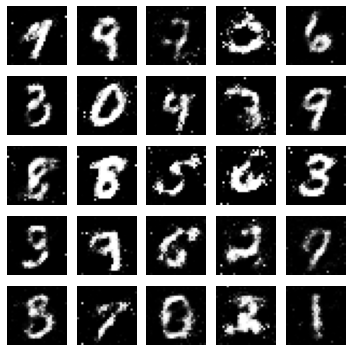

Epoch [35 / 100]  D_loss:0.8978 G_loss:1.3835 


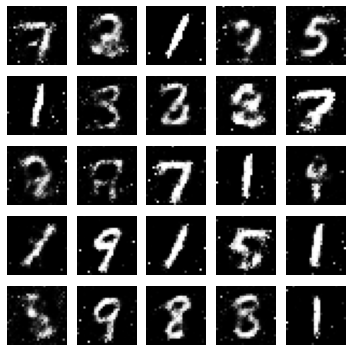

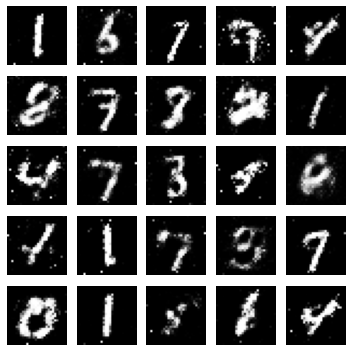

Epoch [36 / 100]  D_loss:0.9514 G_loss:1.4675 


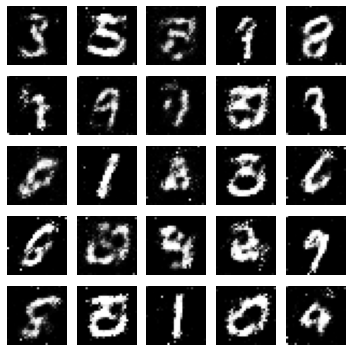

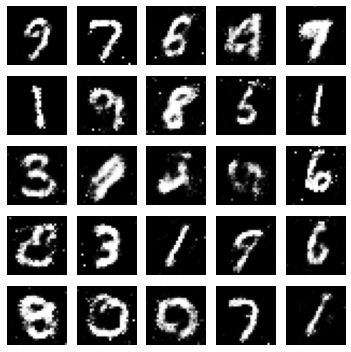

Epoch [37 / 100]  D_loss:0.9865 G_loss:0.8523 


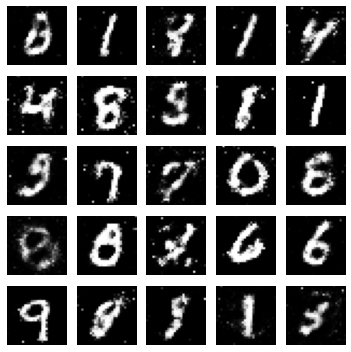

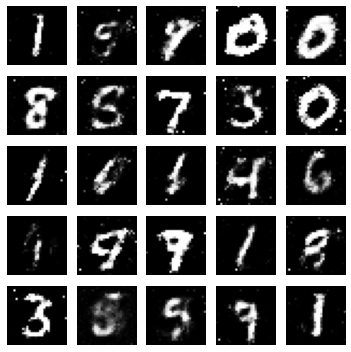

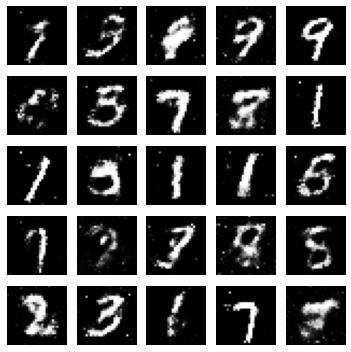

Epoch [38 / 100]  D_loss:1.1151 G_loss:1.0764 


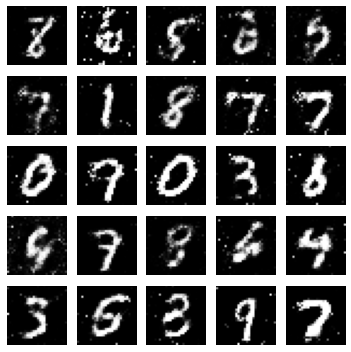

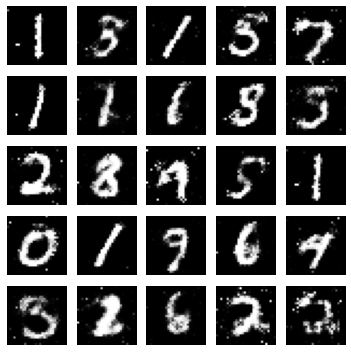

Epoch [39 / 100]  D_loss:0.9234 G_loss:1.9159 


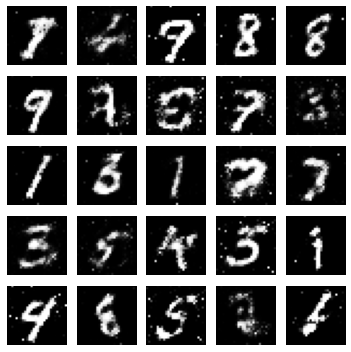

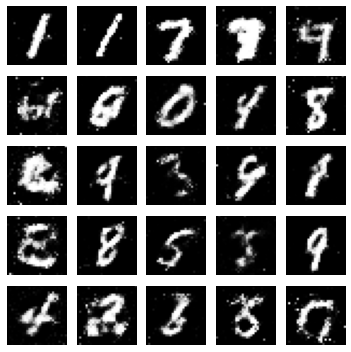

Epoch [40 / 100]  D_loss:0.9093 G_loss:1.3952 


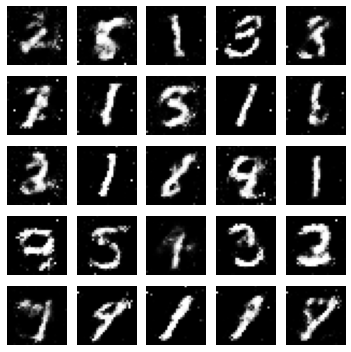

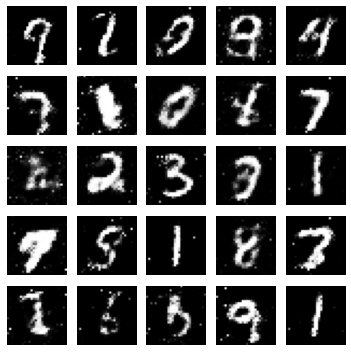

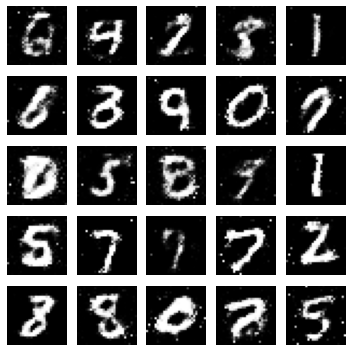

Epoch [41 / 100]  D_loss:1.0642 G_loss:1.3999 


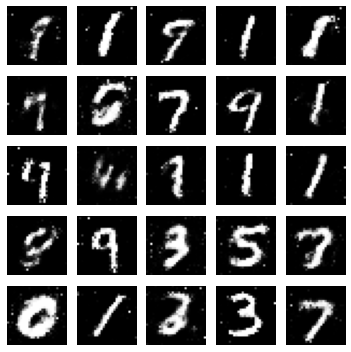

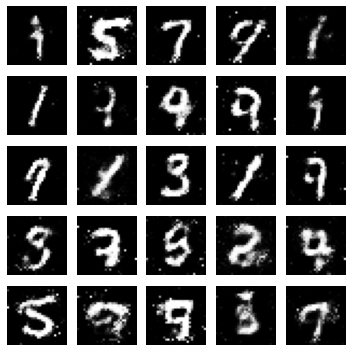

Epoch [42 / 100]  D_loss:1.0323 G_loss:1.5169 


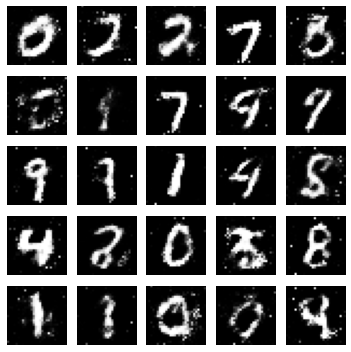

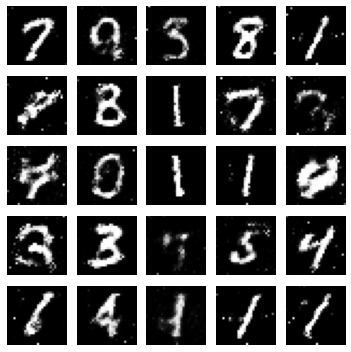

Epoch [43 / 100]  D_loss:1.1662 G_loss:1.4217 


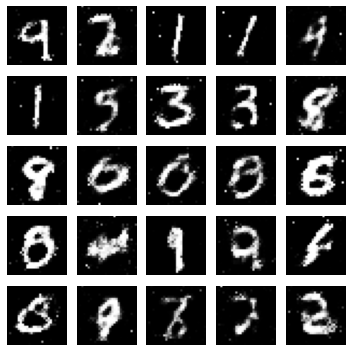

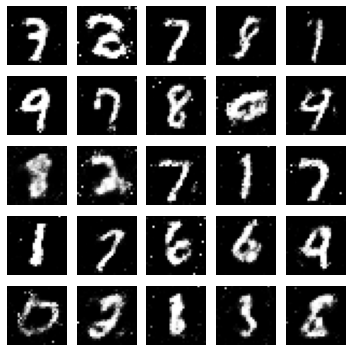

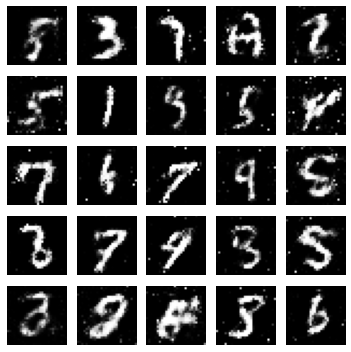

Epoch [44 / 100]  D_loss:1.1295 G_loss:1.7829 


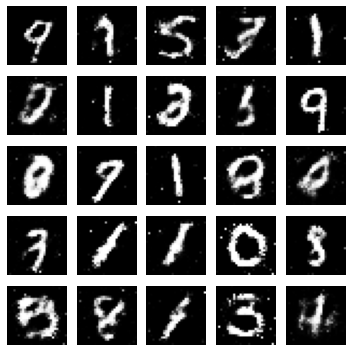

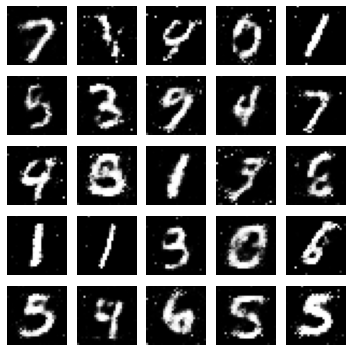

Epoch [45 / 100]  D_loss:0.8854 G_loss:2.2807 


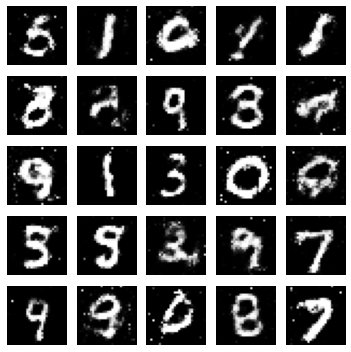

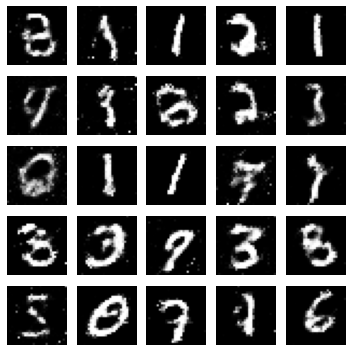

Epoch [46 / 100]  D_loss:0.9075 G_loss:1.2074 


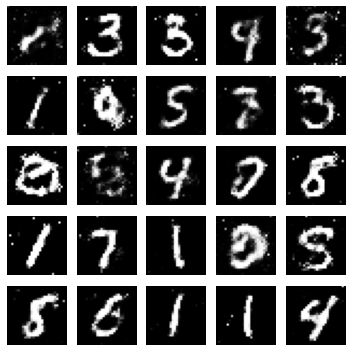

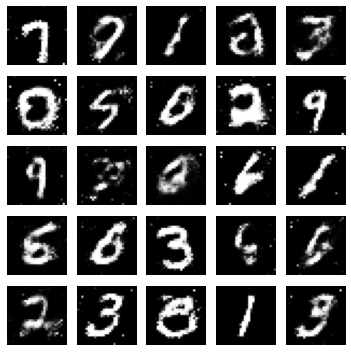

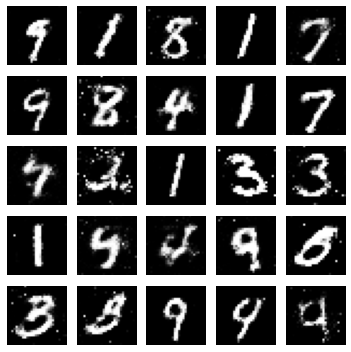

Epoch [47 / 100]  D_loss:0.9160 G_loss:1.5360 


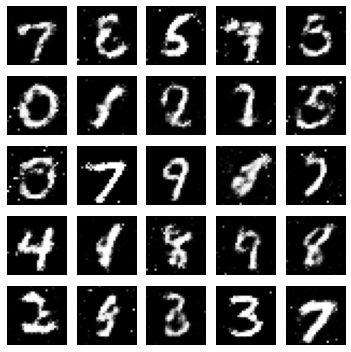

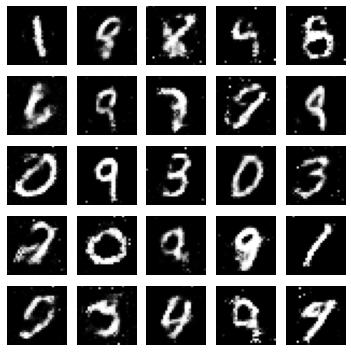

Epoch [48 / 100]  D_loss:1.2417 G_loss:1.4245 


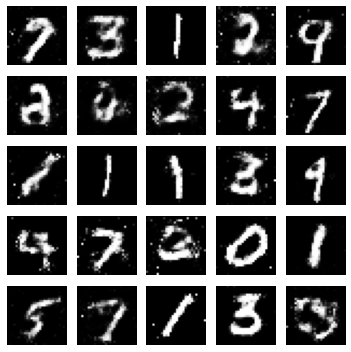

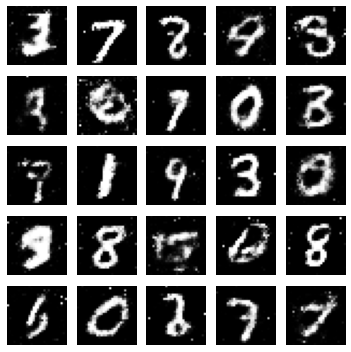

Epoch [49 / 100]  D_loss:0.8610 G_loss:1.3808 


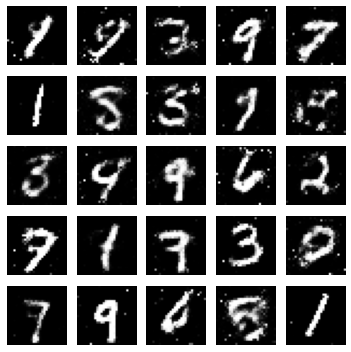

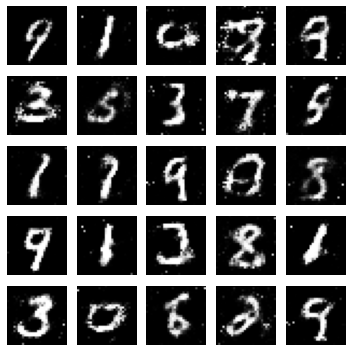

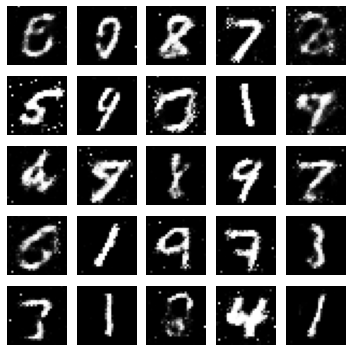

Epoch [50 / 100]  D_loss:1.0765 G_loss:1.0840 


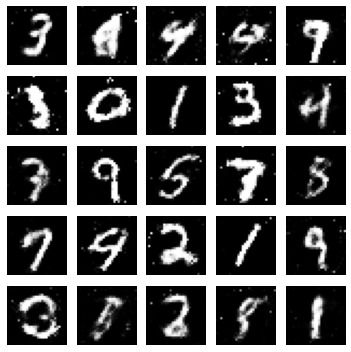

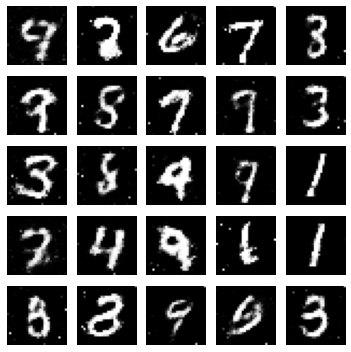

Epoch [51 / 100]  D_loss:1.0582 G_loss:1.7399 


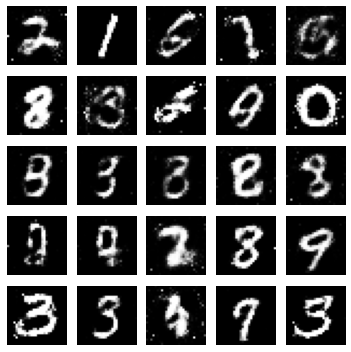

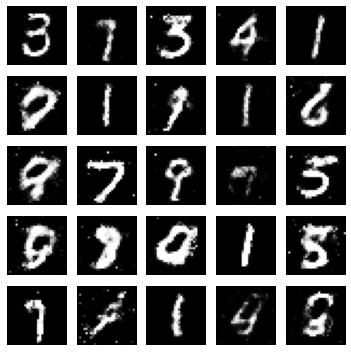

Epoch [52 / 100]  D_loss:0.8520 G_loss:1.3041 


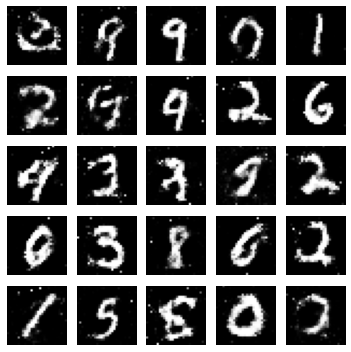

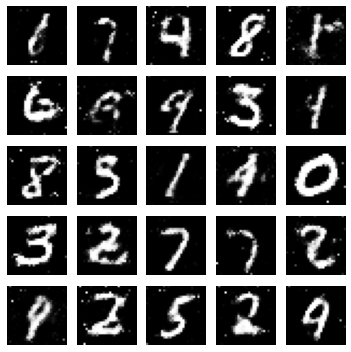

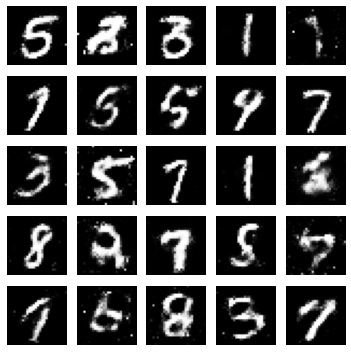

Epoch [53 / 100]  D_loss:0.8804 G_loss:1.7206 


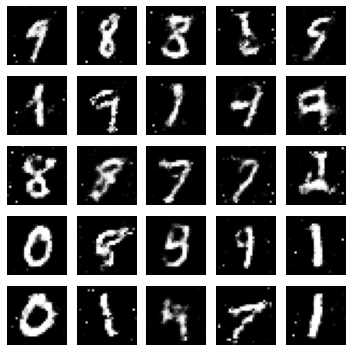

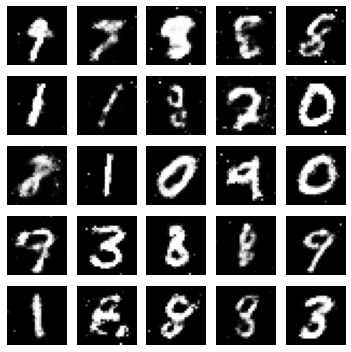

Epoch [54 / 100]  D_loss:1.2905 G_loss:2.1110 


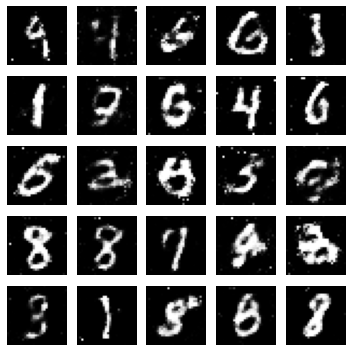

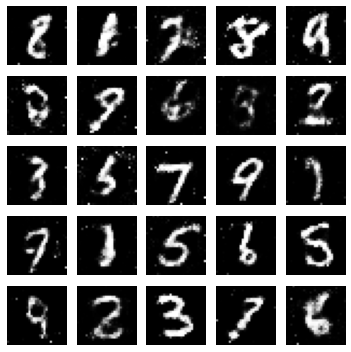

Epoch [55 / 100]  D_loss:1.0794 G_loss:1.1285 


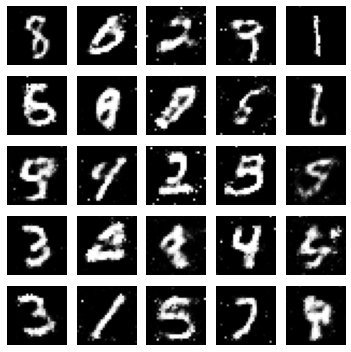

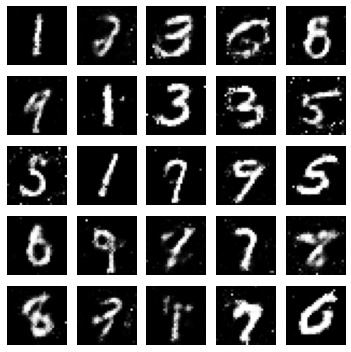

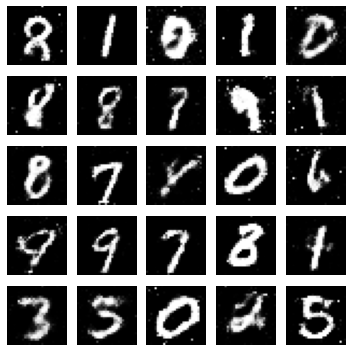

Epoch [56 / 100]  D_loss:1.1859 G_loss:1.5649 


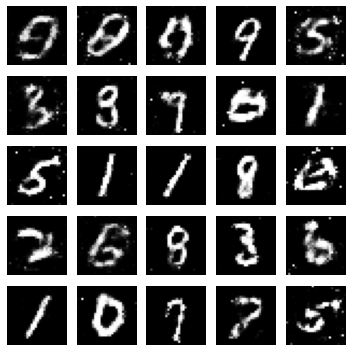

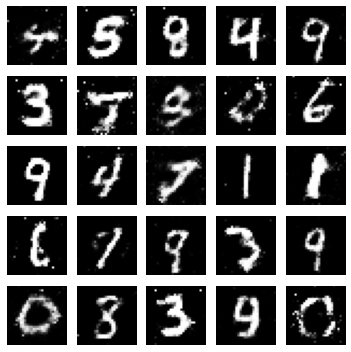

Epoch [57 / 100]  D_loss:1.0164 G_loss:1.3769 


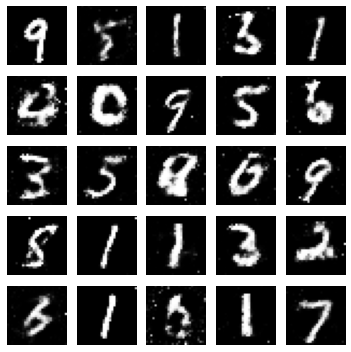

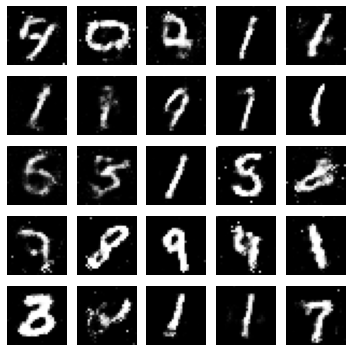

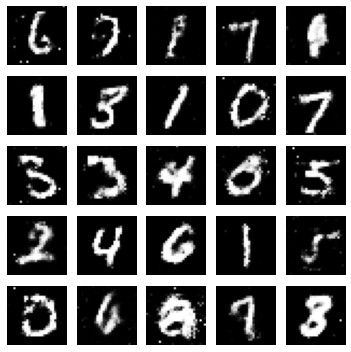

Epoch [58 / 100]  D_loss:1.2561 G_loss:1.2261 


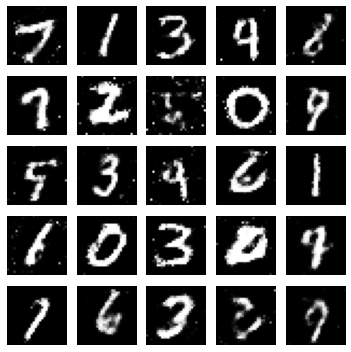

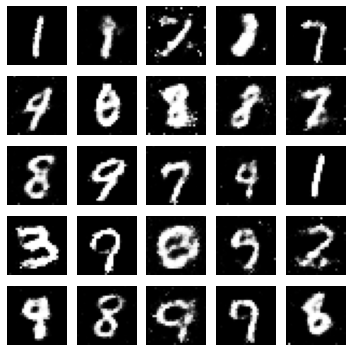

Epoch [59 / 100]  D_loss:1.2768 G_loss:1.3540 


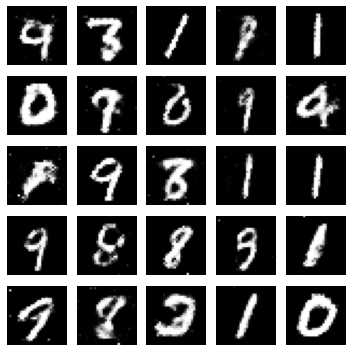

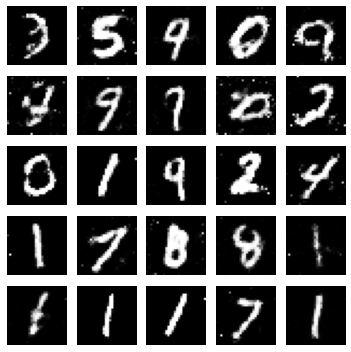

Epoch [60 / 100]  D_loss:0.9299 G_loss:1.5589 


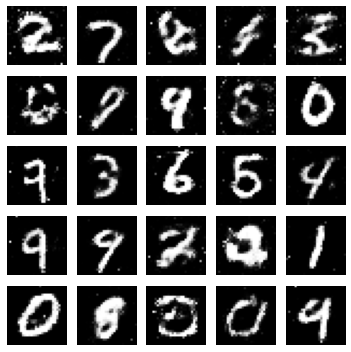

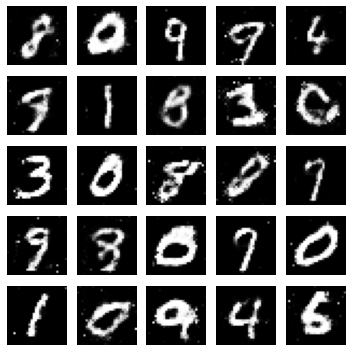

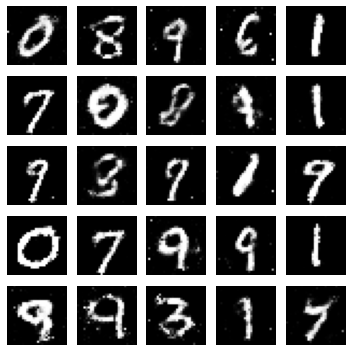

Epoch [61 / 100]  D_loss:1.1370 G_loss:1.1582 


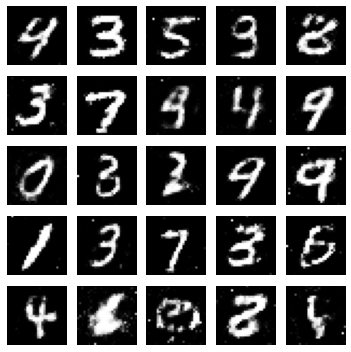

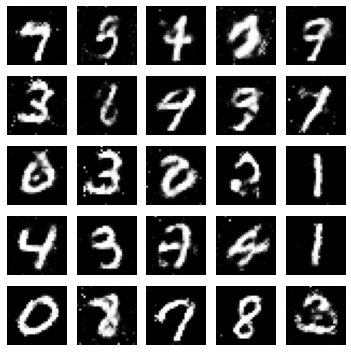

Epoch [62 / 100]  D_loss:1.0719 G_loss:1.7012 


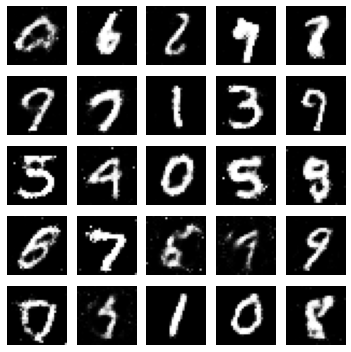

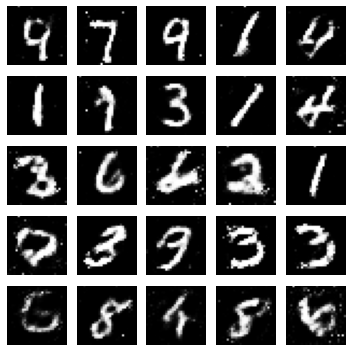

Epoch [63 / 100]  D_loss:0.9143 G_loss:1.2799 


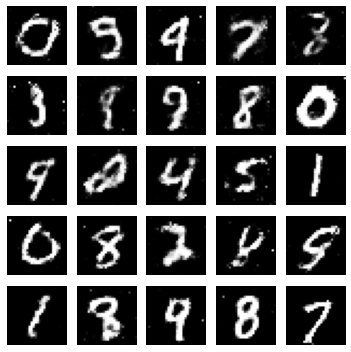

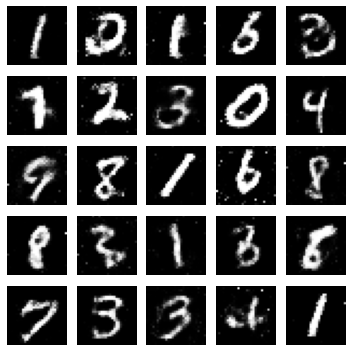

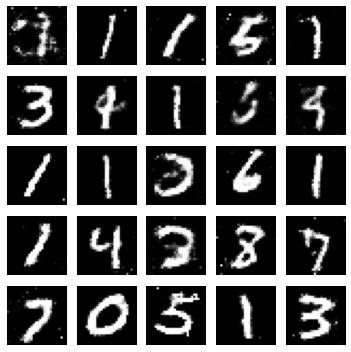

Epoch [64 / 100]  D_loss:1.0026 G_loss:1.3764 


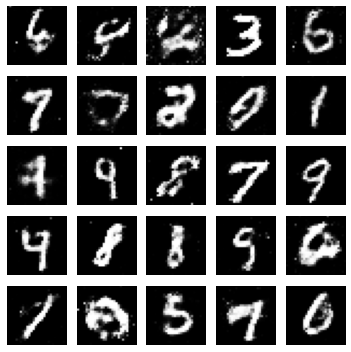

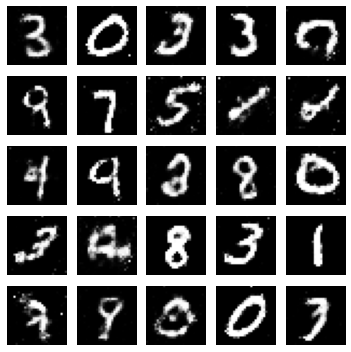

Epoch [65 / 100]  D_loss:0.8835 G_loss:1.4926 


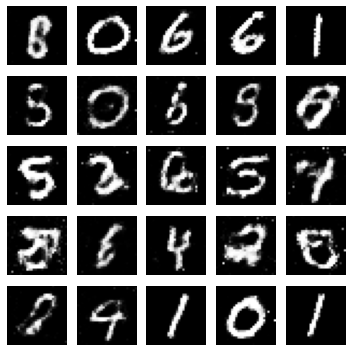

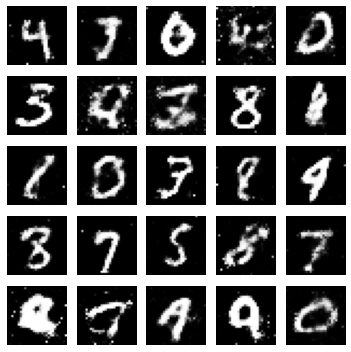

Epoch [66 / 100]  D_loss:1.0174 G_loss:1.0859 


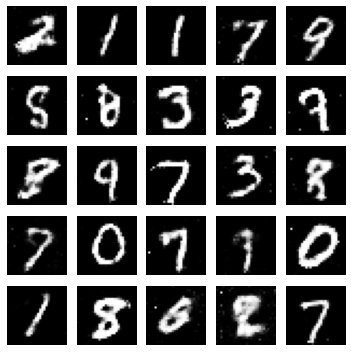

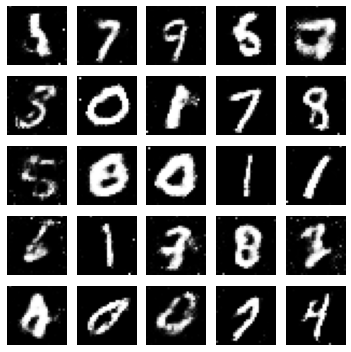

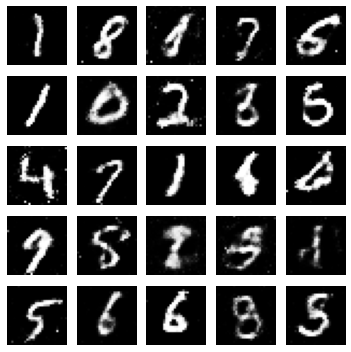

Epoch [67 / 100]  D_loss:0.9678 G_loss:1.1533 


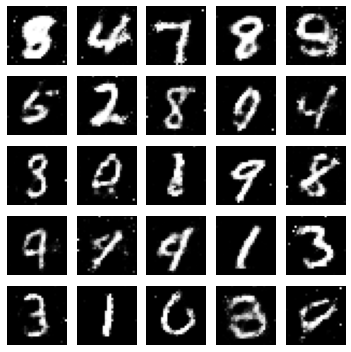

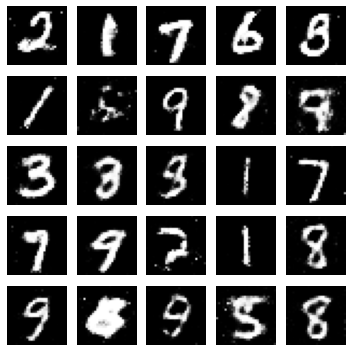

Epoch [68 / 100]  D_loss:0.9530 G_loss:1.1291 


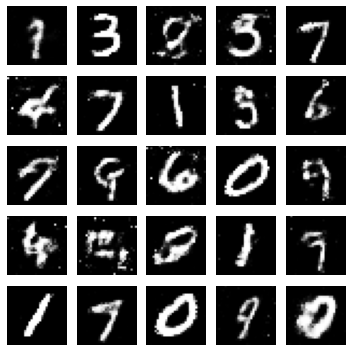

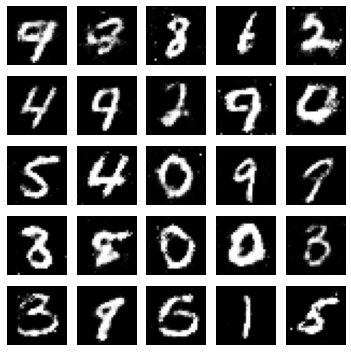

Epoch [69 / 100]  D_loss:1.1574 G_loss:1.0535 


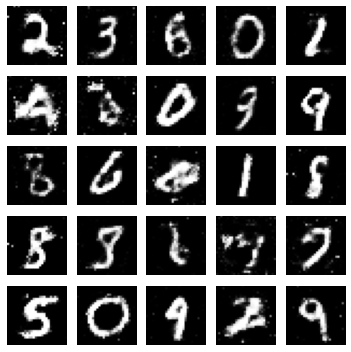

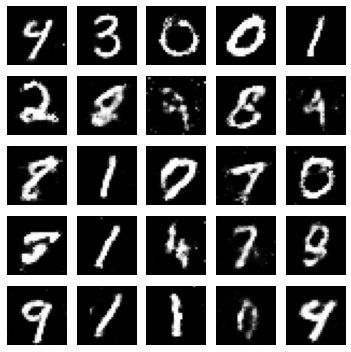

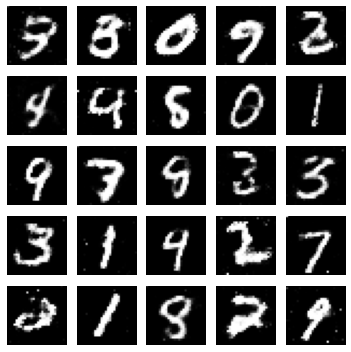

Epoch [70 / 100]  D_loss:1.2171 G_loss:1.2075 


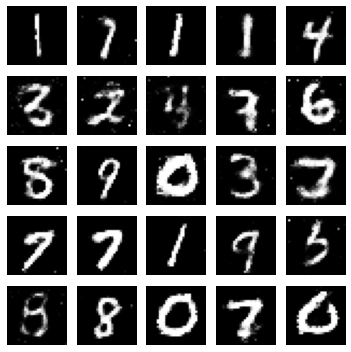

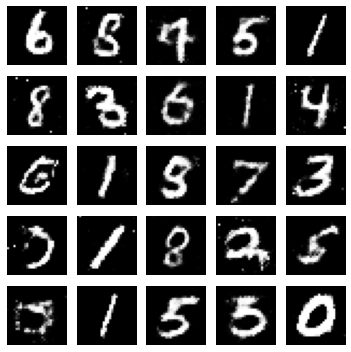

Epoch [71 / 100]  D_loss:0.9825 G_loss:1.1366 


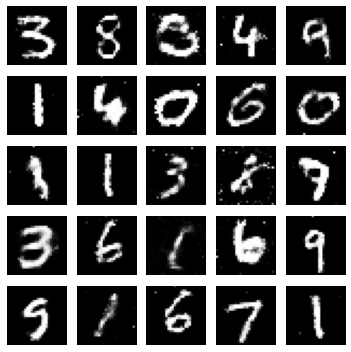

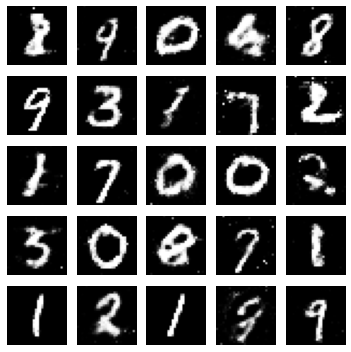

Epoch [72 / 100]  D_loss:1.1233 G_loss:1.5264 


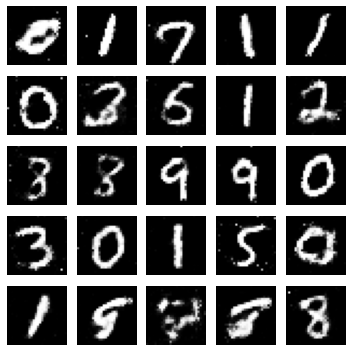

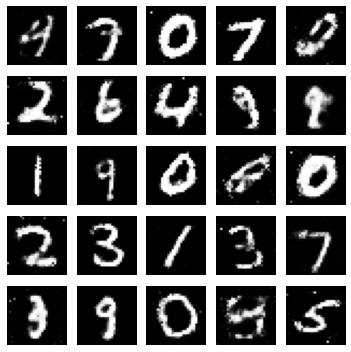

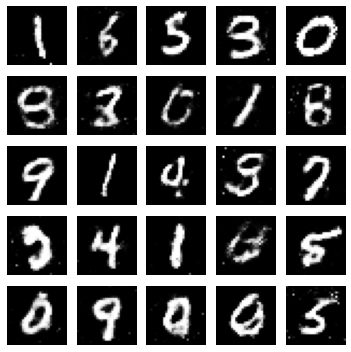

Epoch [73 / 100]  D_loss:1.0334 G_loss:1.7908 


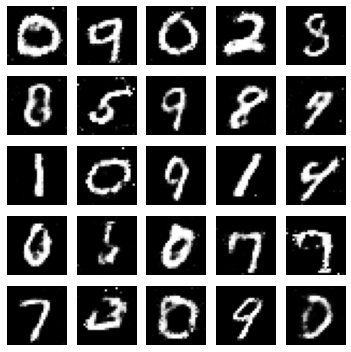

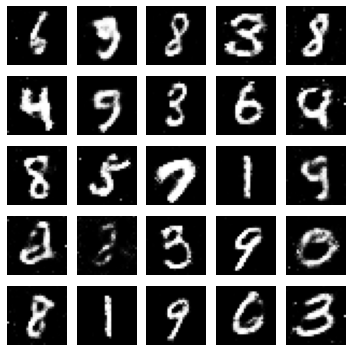

Epoch [74 / 100]  D_loss:0.9886 G_loss:1.1076 


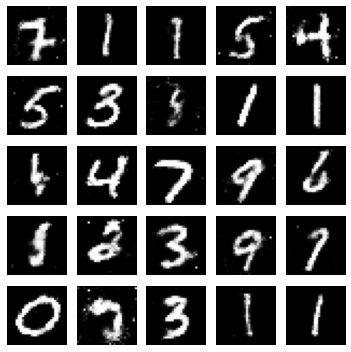

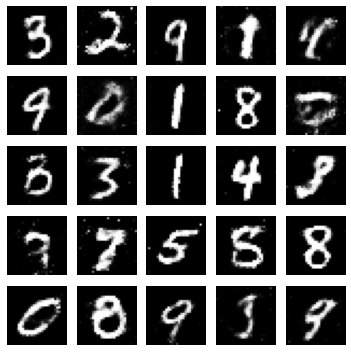

Epoch [75 / 100]  D_loss:1.0817 G_loss:1.2643 


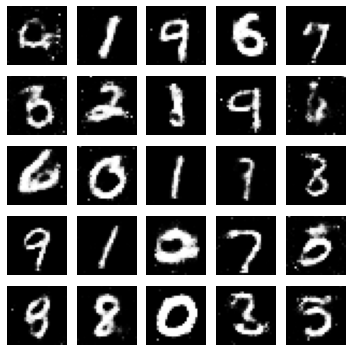

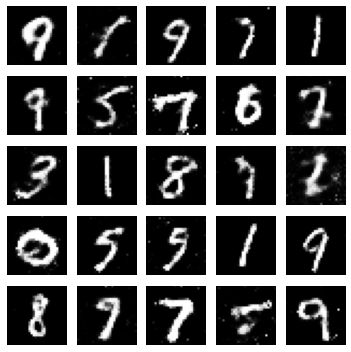

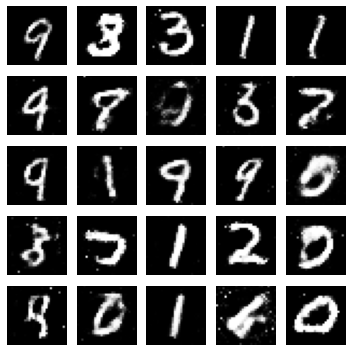

Epoch [76 / 100]  D_loss:1.0361 G_loss:0.9227 


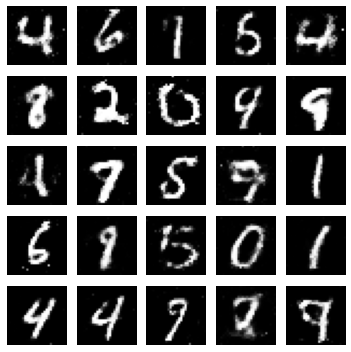

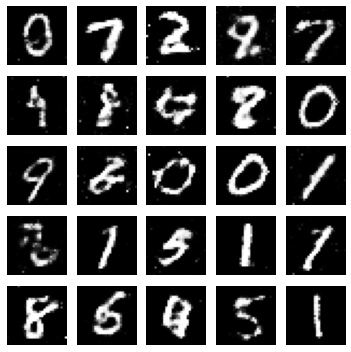

Epoch [77 / 100]  D_loss:0.8718 G_loss:1.4918 


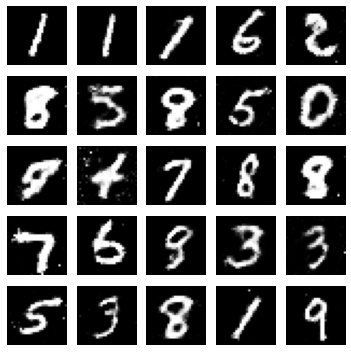

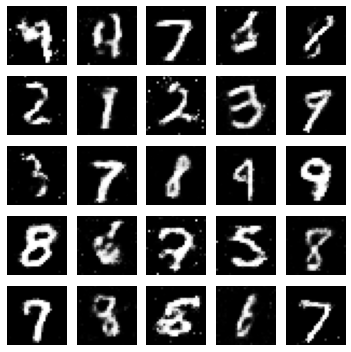

Epoch [78 / 100]  D_loss:0.9030 G_loss:1.5318 


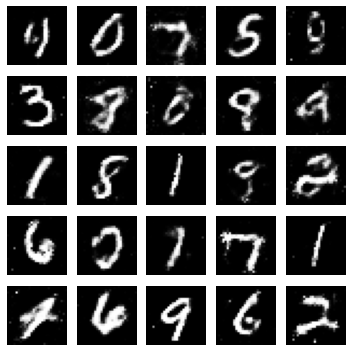

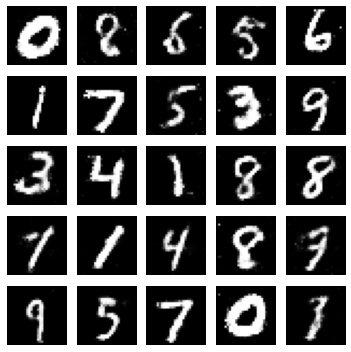

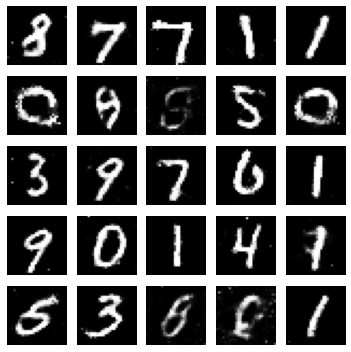

Epoch [79 / 100]  D_loss:1.1795 G_loss:1.0972 


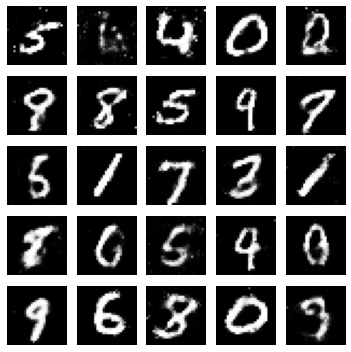

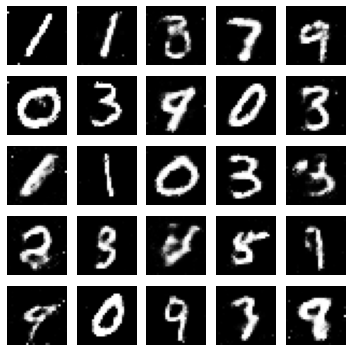

Epoch [80 / 100]  D_loss:1.1301 G_loss:1.0278 


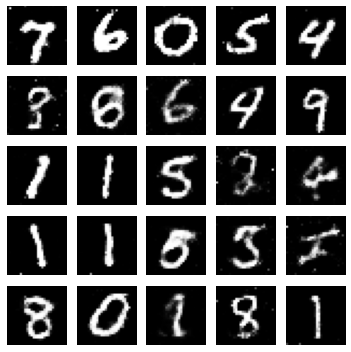

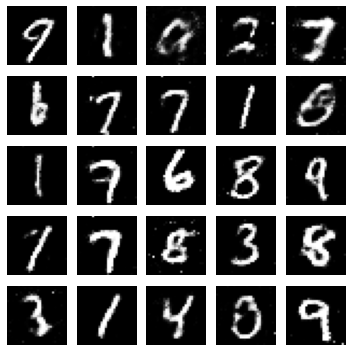

Epoch [81 / 100]  D_loss:1.2498 G_loss:1.3231 


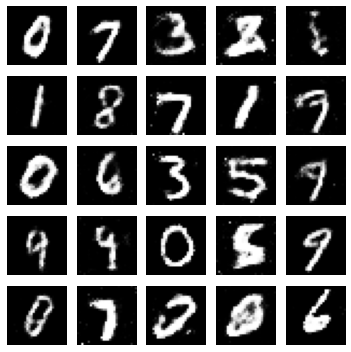

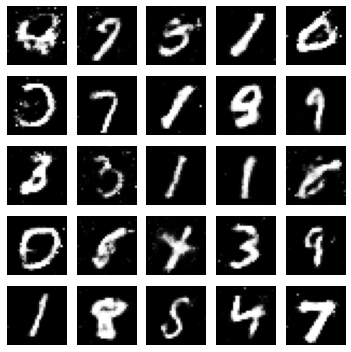

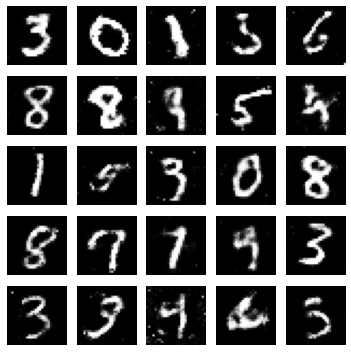

Epoch [82 / 100]  D_loss:1.0015 G_loss:1.4719 


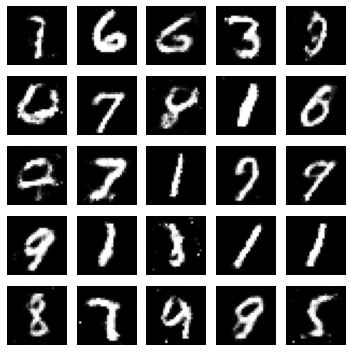

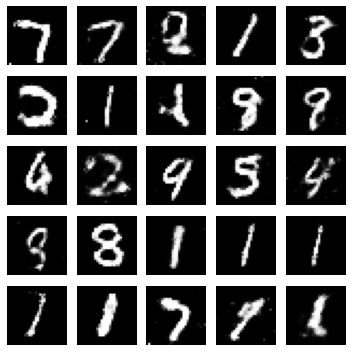

Epoch [83 / 100]  D_loss:1.1043 G_loss:1.4053 


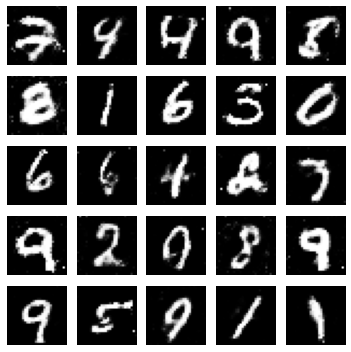

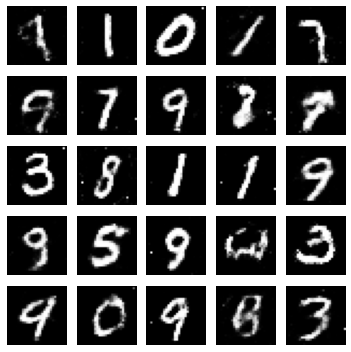

Epoch [84 / 100]  D_loss:0.8938 G_loss:1.1296 


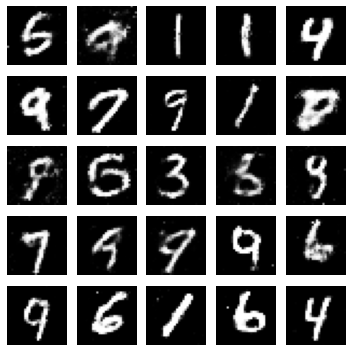

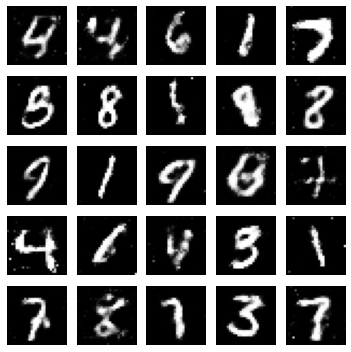

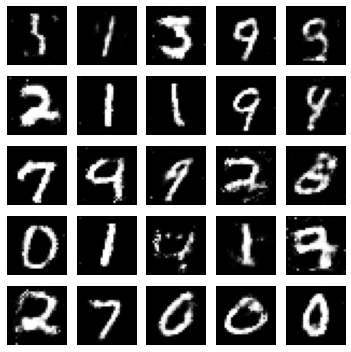

Epoch [85 / 100]  D_loss:1.0549 G_loss:1.1744 


KeyboardInterrupt: 

In [11]:
# 訓練loop
for epoch in range(epochs):
    for i, (imgs, _) in enumerate(train_loader):
        ## 訓練判別器D
        real_imgs = imgs
        z = torch.randn(imgs.size(0), latent_dim)
        fake_imgs = generator(z)        
        # 判別器給真實圖片和生成圖片的分數
        real_validity = discriminator(real_imgs)
        fake_validity = discriminator(fake_imgs)                
        d_loss_real = criterion(real_validity, torch.ones_like(real_validity))
        # torch.ones_like: https://blog.csdn.net/tszupup/article/details/108130721
        d_loss_fake = criterion(fake_validity, torch.zeros_like(fake_validity))
        d_loss = d_loss_real + d_loss_fake        
        # 參數更新(訓練)
        optimizer_D.zero_grad()
        d_loss.backward()
        optimizer_D.step() #梯度
        
        ## 訓練生成器G
        z = torch.randn(imgs.size(0), latent_dim)
        fake_imgs = generator(z)        
        fake_validity = discriminator(fake_imgs)
        g_loss = criterion(fake_validity, torch.ones_like(fake_validity))
        # 參數更新(訓練)
        optimizer_G.zero_grad()
        g_loss.backward()
        optimizer_G.step() #梯度
        
        # 訓練過程生圖像
        batches_done = epoch * len(train_loader) + i
        # batches_done 用來計算在整個訓練過程中，已經處理過的批次（batch）數量
        if batches_done % sample_interval ==0:
            # 生成一批圖像並顯示
            z = torch.randn(25, latent_dim)
            gen_imgs = generator(z) 
            gen_imgs = gen_imgs.view(25,1,28,28)
            img_list.append(gen_imgs)
            
            plt.figure(figsize=(5,5))
            for i in range(25):
                plt.subplot(5,5, i+1) #在5*5網格中把圖片塞到i+1的位置
                plt.imshow(gen_imgs[i].detach().numpy().squeeze(), cmap='gray') 
                # gen_imgs形狀可能是[1,28,28] -> squeeze() -> [28,28]
                # detach: https://blog.csdn.net/qq_27825451/article/details/95498211
                plt.axis('off') #關閉坐標軸
            plt.tight_layout() #確保圖之間的layout合適，沒有不必要的空白或重疊
            plt.show()
        
        #紀錄每次epoch的loss
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
    
    print(f"Epoch [{epoch+1} / {epochs}]  D_loss:{d_loss.item():.4f} G_loss:{g_loss.item():.4f} ")
        

plt.tight_layout():
https://www.osgeo.cn/matplotlib/tutorials/intermediate/tight_layout_guide.html
https://www.cupoy.com/qa/collection/00000174C4BC1B93000000016375706F795F70726572656C656173654355/000001754997FEB0000000276375706F795F72656C656173654349/0000017DD18F8DFD000000026375706F795F72656C656173655155455354

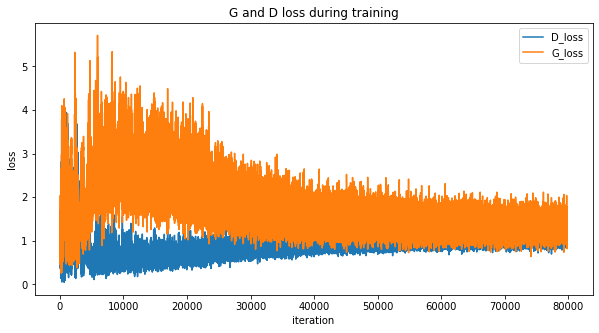

In [12]:
plt.figure(figsize=(10,5))
plt.title("G and D loss during training")
plt.plot(d_losses, label="D_loss")
plt.plot(g_losses, label="G_loss")
plt.xlabel("iteration")
plt.ylabel("loss")
plt.legend()
plt.show()

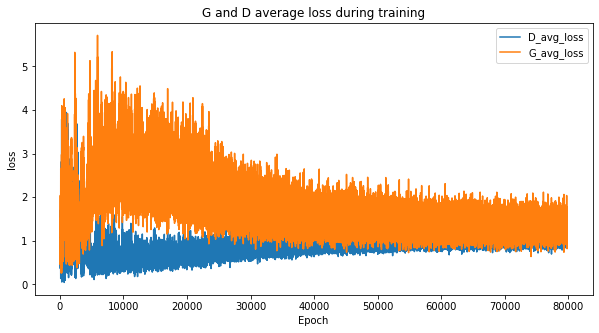

In [14]:
# 假設每個epoch有n_batches
n_batches = len(train_loader)

# 算每個epoch平均損失
avg_d_loss = [sum(d_losses[i*n_batches: (i+1)*n_batches])/n_batches for i in range(epochs)]
avg_g_loss = [sum(g_losses[i*n_batches: (i+1)*n_batches])/n_batches for i in range(epochs)]

plt.figure(figsize=(10,5))
plt.title("G and D average loss during training")
plt.plot(d_losses, label="D_avg_loss")
plt.plot(g_losses, label="G_avg_loss")
plt.xlabel("Epoch")
plt.ylabel("loss")
plt.legend()
plt.show()

In [18]:
with imageio.get_writer('gan_animation.gif', mode='I') as writer:
    # https://blog.csdn.net/weixin_42601547/article/details/129526363
    for imgs in img_list:
        grid = np.zeros((5*28, 5*28))
        for i in range(5):
            for j in range(5):
                grid[i*28: (i+1)*28, j*28: (j+1)*28] = imgs[i*5 + j].detach().cpu().numpy().squeeze()
            
        writer.append_data((grid * 255).astype(np.uint8))
        #把標準化的圖片資料(範圍:[0,1])轉換回[0,255]整數範圍
        # gif格式需要unit8
        
    